In [12]:
import pandas as pd
from pymongo import MongoClient
import matplotlib.pyplot as plt

In [13]:
# Set connection
client = MongoClient("mongodb://localhost:27017/")
db = client["bank"]
balances_collection = db["balances"]

In [14]:
# Fetch balance evolution data from MongoDB
cursor = balances_collection.find({}, {"_id": 0})  # Exclude MongoDB item ID

balances = list(cursor)
balances

[{'date': '2017-01-01',
  'balances': {'0': {'balance': 96646.86},
   '1': {'balance': 80707.36},
   '2': {'balance': 52101.1},
   '3': {'balance': 90980.13},
   '4': {'balance': 91939.93},
   '5': {'balance': 78668.34},
   '6': {'balance': 68656.95},
   '7': {'balance': 98555.2},
   '8': {'balance': 102354.85},
   '9': {'balance': 89159.64},
   '10': {'balance': 93600.78},
   '11': {'balance': 81241.32},
   '12': {'balance': 74253.47},
   '13': {'balance': 99311.68},
   '14': {'balance': 56093.4},
   '15': {'balance': 56133.37},
   '16': {'balance': 50140.73},
   '17': {'balance': 94474.03},
   '18': {'balance': 94051.05},
   '19': {'balance': 79702.65},
   '20': {'balance': 75651.16},
   '21': {'balance': 96495.29},
   '22': {'balance': 94145.77},
   '23': {'balance': 99237.38},
   '24': {'balance': 55564.21},
   '25': {'balance': 99817.35},
   '26': {'balance': 58993.5},
   '27': {'balance': 74505.51},
   '28': {'balance': 70405.61},
   '29': {'balance': 86963.76},
   '30': {'balanc

In [15]:
balances[1]

{'date': '2017-01-02',
 'balances': {'0': {'balance': 95467.28},
  '1': {'balance': 80707.36},
  '2': {'balance': 52101.1},
  '3': {'balance': 90980.13},
  '4': {'balance': 93435.24},
  '5': {'balance': 78668.34},
  '6': {'balance': 69027.48},
  '7': {'balance': 98595.68},
  '8': {'balance': 103240.77},
  '9': {'balance': 88837.31},
  '10': {'balance': 95197.79},
  '11': {'balance': 84840.04},
  '12': {'balance': 74253.47},
  '13': {'balance': 101169.57},
  '14': {'balance': 58145.83},
  '15': {'balance': 57852.11},
  '16': {'balance': 50316.34},
  '17': {'balance': 96724.16},
  '18': {'balance': 94962.48},
  '19': {'balance': 82494.53},
  '20': {'balance': 77530.74},
  '21': {'balance': 97445.71},
  '22': {'balance': 95054.7},
  '23': {'balance': 101495.18},
  '24': {'balance': 57037.92},
  '25': {'balance': 102446.5},
  '26': {'balance': 59732.62},
  '27': {'balance': 74731.7},
  '28': {'balance': 70545.96},
  '29': {'balance': 89062.9},
  '30': {'balance': 61596.08},
  '31': {'balan

In [16]:
#df = pd.DataFrame([{**entry["balances"], "date": entry["date"]} for entry in data])

#print(df.shape) # must be (720, 1447)
#print(df.head())

#      | id1 | id2 | ... | id1446
# day1 |   
# day2 |        balances
# ...

In [17]:
#df

In [18]:
# Check the number of unique dates in extracted data
dates = [entry["date"] for entry in balances]
print("Unique dates found:", len(set(dates)))  # Should be 720
print("First 5 dates:", sorted(set(dates))[:5])
print("Last 5 dates:", sorted(set(dates))[-5:])

Unique dates found: 720
First 5 dates: ['2017-01-01', '2017-01-02', '2017-01-03', '2017-01-04', '2017-01-05']
Last 5 dates: ['2018-12-17', '2018-12-18', '2018-12-19', '2018-12-20', '2018-12-21']


In [19]:
df = pd.DataFrame([
    {key: value["balance"] for key, value in entry["balances"].items()} | {"date": entry["date"]}
    for entry in balances
])

# Convert "date" to datetime and set as index
df["date"] = pd.to_datetime(df["date"])
df.set_index("date", inplace=True)
df.sort_index(inplace=True)

In [20]:
df

,0,1,2,3,4,5,6,7,8,9,...,1436,1437,1438,1439,1440,1441,1442,1443,1444,1445
date,,,,,,,,,,,,,,,,,,,,,
2017-01-01,96646.86,80707.36,52101.10,90980.13,91939.93,78668.34,68656.95,98555.20,102354.85,89159.64,...,70229.95,94670.55,98761.26,50045.72,95536.12,61754.39,88437.72,84987.77,50857.55,75294.22
2017-01-02,95467.28,80707.36,52101.10,90980.13,93435.24,78668.34,69027.48,98595.68,103240.77,88837.31,...,70229.95,94670.55,98761.26,50045.72,95536.12,61213.99,88437.72,84987.77,50857.55,75294.22
2017-01-03,95055.37,80707.36,52101.10,91344.06,93982.73,78840.95,69027.48,98595.68,103767.89,88837.31,...,70229.95,94079.68,98761.26,50045.72,95536.12,61213.99,88437.72,84987.77,49948.70,75294.22
2017-01-04,95055.37,80345.34,51962.78,91856.33,93960.46,78211.41,69027.48,99502.64,104547.57,90397.18,...,70229.95,93578.47,98037.29,50045.72,95210.09,61213.99,88437.72,84987.77,49948.70,75294.22
2017-01-05,95055.37,79735.00,51962.78,91856.33,93960.46,78636.34,69971.54,99502.64,104699.58,90397.18,...,69478.17,93578.47,97720.00,50045.72,94538.76,60637.94,88437.72,84987.77,49948.70,75294.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-17,0.89,56491.31,52314.07,311981.48,288164.33,162774.87,244602.34,463704.20,539722.91,416227.85,...,0.60,0.92,0.91,0.43,0.82,0.56,0.85,25418.18,0.42,16419.10
2018-12-18,0.89,56491.31,52314.07,312208.35,288363.07,163432.26,244850.34,464203.05,539990.42,416227.85,...,0.60,0.92,0.91,0.43,0.82,0.56,0.85,25418.18,0.42,16419.10
2018-12-19,0.89,55738.24,51749.46,312208.35,287732.12,163897.23,245697.78,463659.43,540134.76,417200.15,...,0.60,0.92,0.91,0.43,0.82,0.56,0.85,25418.18,0.42,16419.10


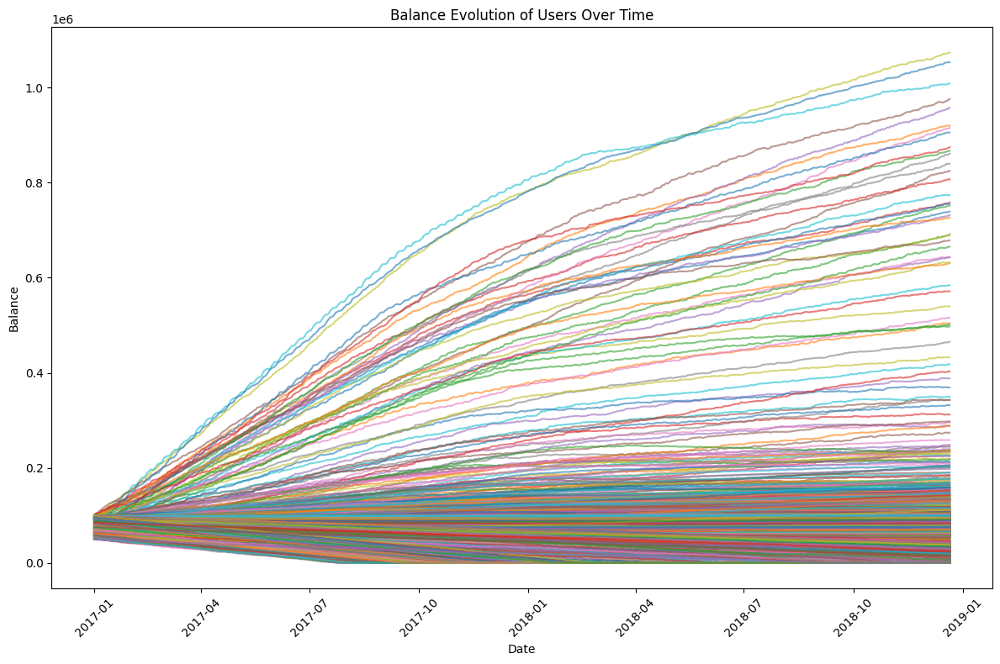

In [22]:
# Plot the balance evolution for all users (columns) as separate lines
plt.figure(figsize=(12, 8))

# Plot each column (account balance) as a line
for user in df.columns:
    plt.plot(df.index, df[user], label=f"User {user}", alpha=0.6)

# Add title and labels
plt.title("Balance Evolution of Users Over Time")
plt.xlabel("Date")
plt.ylabel("Balance")

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Add legend to differentiate users
# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Display the plot
plt.tight_layout()
plt.show()